In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas
import datetime as dt

In [2]:
pd.options.display.max_columns=100
plt.style.use('ggplot')

In [3]:
df=pd.read_csv('csv_files/RealEstate_Georgia.csv')

In [4]:
df=df.drop('Unnamed: 0',axis=1)

In [5]:
df.sample()

,id,stateId,countyId,cityId,country,datePostedString,is_bankOwned,is_forAuction,event,time,price,pricePerSquareFoot,city,state,yearBuilt,streetAddress,zipcode,longitude,latitude,hasBadGeocode,description,currency,livingArea,livingAreaValue,lotAreaUnits,bathrooms,bedrooms,buildingArea,parking,garageSpaces,hasGarage,levels,pool,spa,isNewConstruction,hasPetsAllowed,homeType,county
12200,30305-2093481391,16,67724,37211,USA,2021-07-12,0,0,Listed for sale,1.626048e+12,205900.0,255.0,Atlanta,GA,1988,2870 S Pharr Ct NW APT 307,30305.0,-84.385567,33.833778,0,Beautiful Renovation in the HEART of BUCKHEAD!...,USD,807.0,807.0,sqft,1.0,1.0,807.0,1,1.0,1,One,1,0,0,0,CONDO,Fulton County


In [6]:
df.isna().mean()[df.isna().mean().values>0]

#NaN values

datePostedString    0.000072
time                0.001376
description         0.007172
dtype: float64

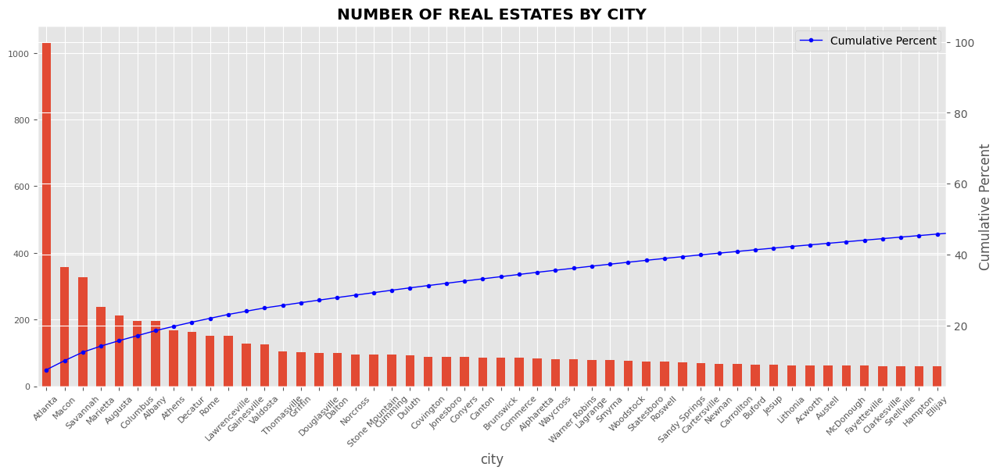

In [7]:
grouped=df.groupby('city')['id'].count().sort_values(ascending=False)
cum=(grouped.values/grouped.values.sum()*100).cumsum()
top_cities=grouped.head(10).index

ax=grouped.head(50).plot(kind='bar',figsize=(15,6),fontsize=8,rot=45)
ax2=ax.twinx()
ax2.plot(grouped.index,cum,color='blue',lw=1,marker='.',label='Cumulative Percent')
ax2.set_ylabel('Cumulative Percent')
ax.set_title('NUMBER OF REAL ESTATES BY CITY',fontweight='bold')
plt.legend()
plt.show()

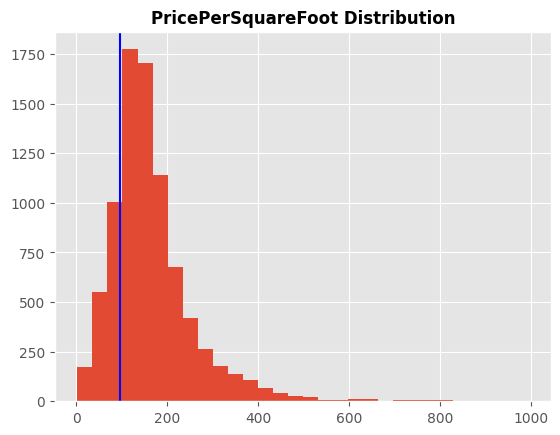

In [8]:
df.query('0<pricePerSquareFoot<10**3')['pricePerSquareFoot'].hist(bins=30)
plt.title('PricePerSquareFoot Distribution',fontweight='bold',size=12)
plt.axvline(df['pricePerSquareFoot'].median(),color='b',label='Median Price')
plt.show()
plt.show()

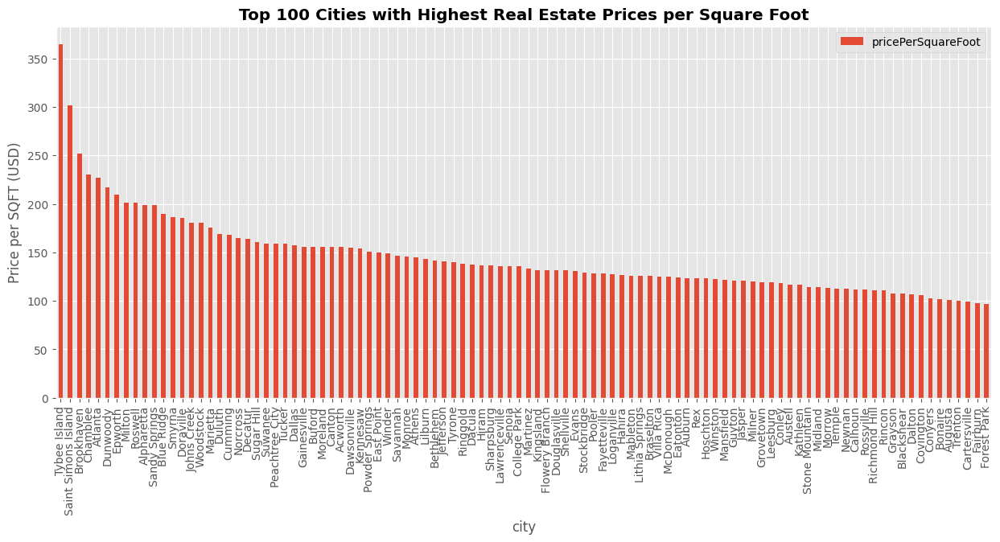

In [9]:
grouped=df.groupby('city').agg({'pricePerSquareFoot':'median','id':'count'}).reset_index().sort_values('pricePerSquareFoot',ascending=False)
grouped=grouped[grouped['id']>15].head(100)

fig,ax=plt.subplots(figsize=(15,6))
grouped.plot.bar(ax=ax,x='city',y='pricePerSquareFoot')
ax.set_title('Top 100 Cities with Highest Real Estate Prices per Square Foot',fontweight='bold')
ax.set_ylabel('Price per SQFT (USD)')
plt.show()

In [10]:
%%time
zips=geopandas.read_file(r"C:\Users\berid\python\geopandas\tl_2019_us_zcta510_zipcodes\tl_2019_us_zcta510.shp")

CPU times: total: 2min 28s
Wall time: 2min 56s


In [11]:
df['zipcode']=df['zipcode'].astype(int).astype(str)

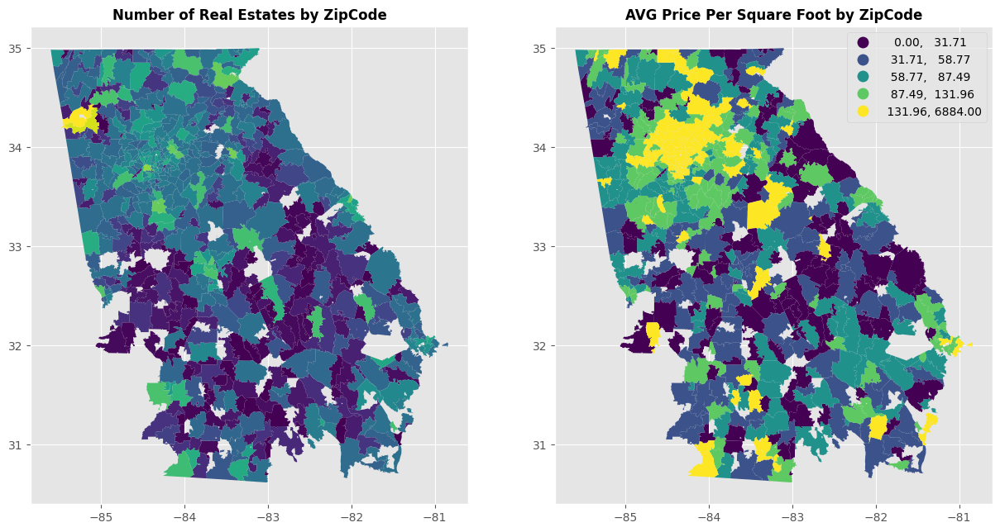

In [12]:
grouped=df.groupby('zipcode').agg({'pricePerSquareFoot':'mean','id':'count'}).reset_index()
grouped=grouped.merge(zips[['GEOID10','geometry']],left_on='zipcode',right_on='GEOID10')
grouped=geopandas.GeoDataFrame(grouped)

fig,(ax1,ax2)=plt.subplots(1,2,figsize=(15,10))
grouped.plot(ax=ax1,column='id')
grouped.plot(ax=ax2,column='pricePerSquareFoot',scheme='quantiles',legend=True)
ax1.set_title('Number of Real Estates by ZipCode',fontweight='bold',size=12)
ax2.set_title('AVG Price Per Square Foot by ZipCode',fontweight='bold',size=12)
plt.show()

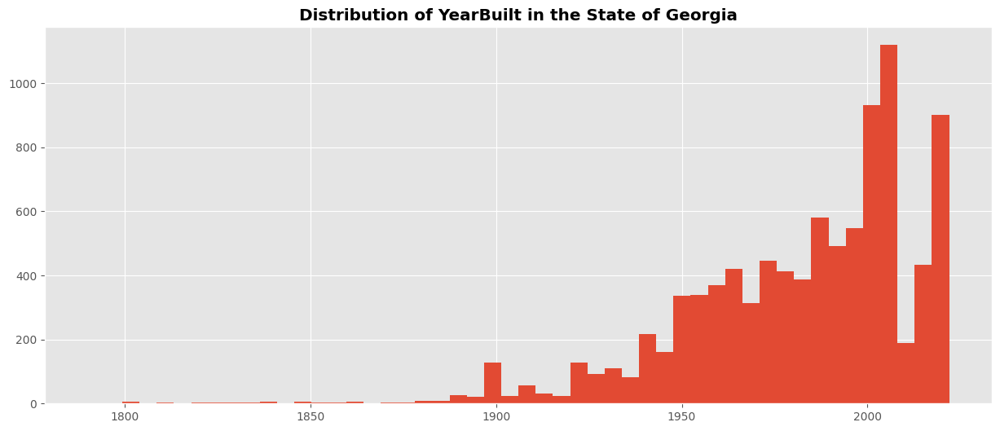

In [13]:
plt.figure(figsize=(15,6))
df.query('yearBuilt>0 and yearBuilt<2023')['yearBuilt'].hist(bins=50)
plt.title('Distribution of YearBuilt in the State of Georgia',fontweight='bold')
plt.show()

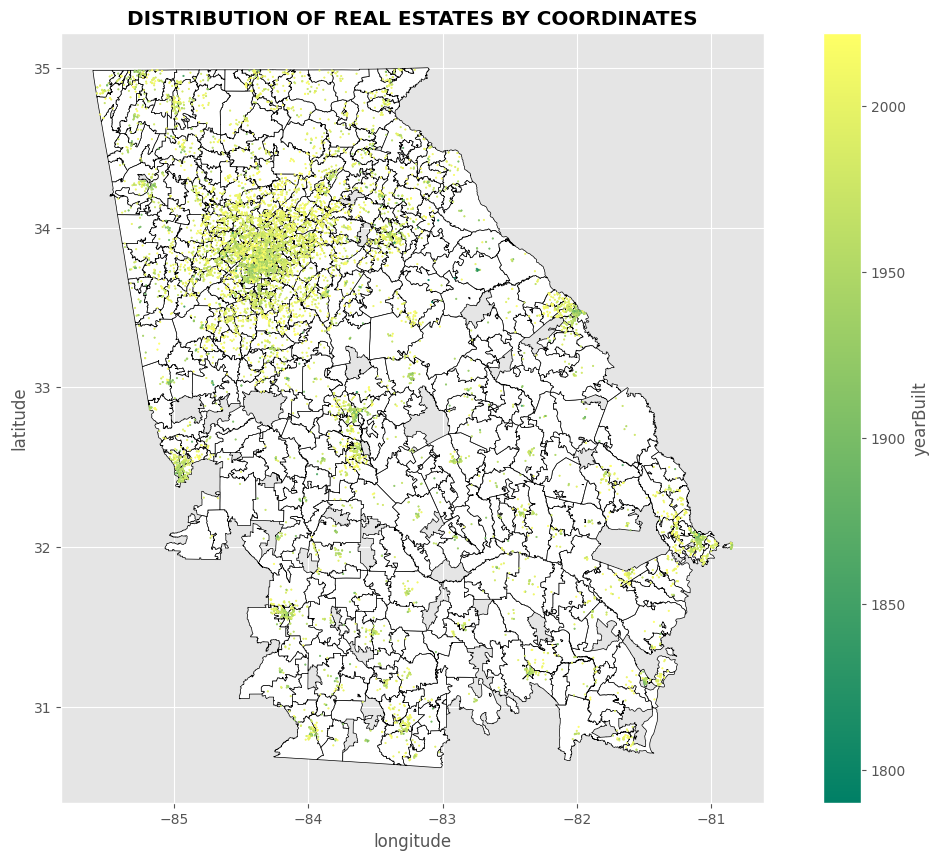

In [14]:
grouped=df.groupby('zipcode').agg({'yearBuilt':'median','id':'count'})
grouped=grouped.query('0<yearBuilt<2023')

fig,ax=plt.subplots(figsize=(15,10))
zips[zips['GEOID10'].isin(df['zipcode'].unique())].plot(color='white',ec='black',ax=ax)
df.query('0<yearBuilt<2023').plot.scatter(ax=ax,x='longitude',y='latitude',c='yearBuilt',cmap='summer',s=1)
#sns.kdeplot(df.sample(3*10**3),x='longitude',y='latitude',levels=10,color='r',linewidths=0.5,ax=ax)
plt.title('DISTRIBUTION OF REAL ESTATES BY COORDINATES',fontweight='bold')
plt.show()

### Creating a Folium map 

In [15]:
import folium

In [16]:
grouped=df.groupby('zipcode').agg({'pricePerSquareFoot':'mean','id':'count'}).reset_index()
grouped=grouped.merge(zips[['GEOID10','geometry']],left_on='zipcode',right_on='GEOID10')
grouped['bins']=grouped['pricePerSquareFoot'].apply(lambda x:
                                  '0-100' if 0<x<=100 else
                                  '100-200' if 100<x<=200 else
                                   '200-400' if 200<x<=400 else
                                   '400-1000' if 400<x<=1000 else
                                   '+1000' if 1000<x else None)
grouped=geopandas.GeoDataFrame(grouped)

m=grouped.explore(column='bins',cmap='jet')
#for long,lat,city in zip(df.sample(100)['longitude'],df.sample(100)['latitude'],df.sample(100)['city']):
#    folium.Marker([lat,long],
#                  icon=folium.Icon(icon="home",color='red',size=(1,1)),
#                  popup=f"<i>{city}</i>"
#                 ).add_to(m)
folium.LayerControl().add_to(m)
m

In [17]:
m.save('folium1.html')

In [18]:
from folium import plugins

In [19]:
coordinates=[(lat,long) for lat,long in zip(df['latitude'],df['longitude'])]

m=folium.Map(location=[33.5,-82.5],tiles='cartodb dark_matter',zoom_start=6)
plugins.HeatMap(data=coordinates,radius=10,min_opacity=0.1,blur=1).add_to(m)
folium.LayerControl().add_to(m)

m

# heatmap of Real Estate dispersion on map

In [20]:
m.save('folium2.html')